# Problem & Solution

# Library

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
import warnings
warnings.filterwarnings('ignore')

In [ ]:
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 16 not upgraded.
Need to get 10.3 MB of archives.
After this operation, 34.1 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 fonts-nanum all 20200506-1 [10.3 MB]
Fetched 10.3 MB in 1s (20.0 MB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype
dpkg-preconfigure: unable to re-open stdin: 
Selecting previously unselected package fonts-nanum.
(Reading database ... 120831 files and direc

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import matplotlib.pyplot as plt

plt.rc('font', family='NanumBarunGothic')

In [ ]:
!pip install ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.3/356.3 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 37.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 20.2 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27079 sha256=53a51567070de6ac2f6b9a68bf3d639dc3d1aa365af54bce79604b2aeb7201bf
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: wordcloud
    Found existing installation: wordcloud 1.8.2.2
    Uninstalling wordcloud-1.8.2.2:
      Successfully uninstalled wordcloud-1.8.2.2


# Load Data

In [ ]:
dir = "/content/drive/MyDrive/Datasets/데이콘/power_usage/open"

train = pd.read_csv(dir + "/train.csv").drop(['num_date_time','일조(hr)','일사(MJ/m2)'],1)
test = pd.read_csv(dir + "/test.csv").drop('num_date_time',1)
building = pd.read_csv(dir + "/building_info.csv")
ss = pd.read_csv(dir + "/sample_submission.csv")

# Data Wragling

In [ ]:
train.shape, test.shape

((204000, 7), (16800, 6))

In [ ]:
train.head()

,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh)
0,1,20220601 00,18.6,NaN,0.9,42.0,NaN,NaN,1085.28
1,1,20220601 01,18.0,NaN,1.1,45.0,NaN,NaN,1047.36
2,1,20220601 02,17.7,NaN,1.5,45.0,NaN,NaN,974.88
3,1,20220601 03,16.7,NaN,1.4,48.0,NaN,NaN,953.76
4,1,20220601 04,18.4,NaN,2.8,43.0,NaN,NaN,986.40


In [ ]:
test.head()

,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%)
0,1,20220825 00,23.5,0.0,2.2,72
1,1,20220825 01,23.0,0.0,0.9,72
2,1,20220825 02,22.7,0.0,1.5,75
3,1,20220825 03,22.1,0.0,1.3,78
4,1,20220825 04,21.8,0.0,1.0,77


훈련 데이터와 테스트 데이터의 컬럼이 다르다. `일조(hr)`과 `일사(MJ/m2)`를 제거하기엔 아깝기 때문에, 학습을 시켜보고 변수가 필요하다면 먼저 `일조(hr)`과 `일사(MJ/m2)`를 예측하고 최종적으로 Target 값을 에측하고자 한다.

In [ ]:
df = pd.concat([train,test])
df = df.merge(building)

# Data preprocessing

In [ ]:
#일시 컬럼 변경
df['일시'] = pd.to_datetime(df['일시'], format='%Y%m%d %H')
# 연도, 월, 일, 시간 변수 생성

def convert_datetime(df):
  df['연도'] = df['일시'].dt.year
  df['월'] = df['일시'].dt.month
  df['일'] = df['일시'].dt.day
  df['시간'] = df['일시'].dt.hour
  df['일주일'] = df['일시'].dt.dayofweek
  df['연중주'] = df['일시'].dt.weekofyear
  df['연중일'] = df['일시'].dt.dayofyear
  df['분기'] = df['일시'].dt.quarter
  return df

df = convert_datetime(df)

In [ ]:
df['태양광용량(kW)'] = df['태양광용량(kW)'].apply(lambda x: np.nan if x=='-' else x)
df['ESS저장용량(kWh)'] = df['ESS저장용량(kWh)'].apply(lambda x: np.nan if x=='-' else x)
df['PCS용량(kW)'] = df['PCS용량(kW)'].apply(lambda x: np.nan if x=='-' else x)

df['태양광용량(kW)'] = df['태양광용량(kW)'].astype('float')
df['ESS저장용량(kWh)'] = df['ESS저장용량(kWh)'].astype('float')
df['PCS용량(kW)'] = df['PCS용량(kW)'].astype('float')

# EDA & Visualization

In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df ,title="Profiling report")

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
int_features = df.select_dtypes(include='int64').columns.tolist()
float_features = df.select_dtypes(include='float64').columns.tolist()
cat_features = df.select_dtypes(include='object').columns.tolist()

## Int features

<Figure size 640x480 with 0 Axes>

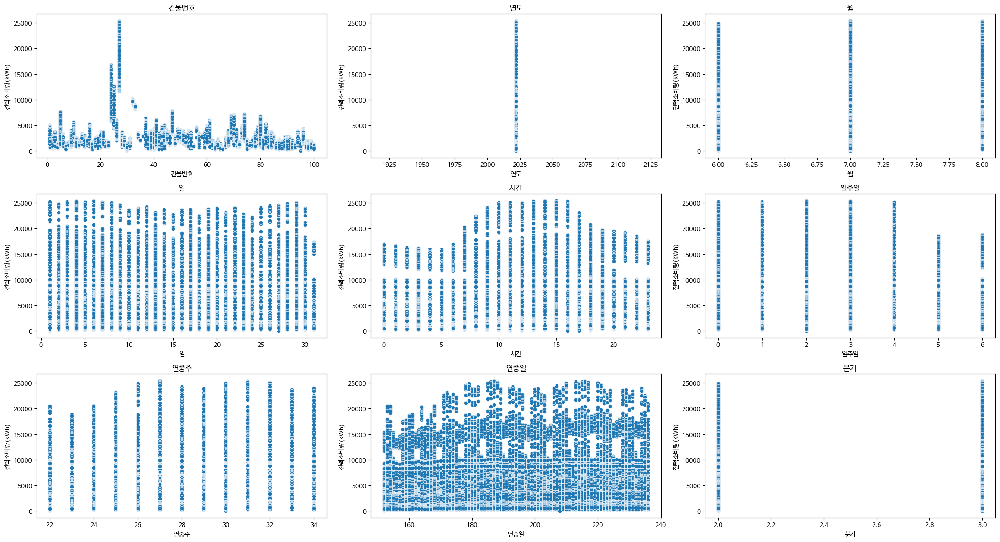

In [ ]:
def show_int_scatter(df, columns):
  i = 0
  plt.figure()
  plt.subplots(3,3,figsize=(22,12))
  for col in columns:
    i += 1
    plt.subplot(3,3,i)
    plt.title(f"{col}")
    sns.scatterplot(x=df[col], y=df['전력소비량(kWh)'])
  plt.tight_layout()
  plt.show()

show_int_scatter(df, int_features)

## Float features

<Figure size 640x480 with 0 Axes>

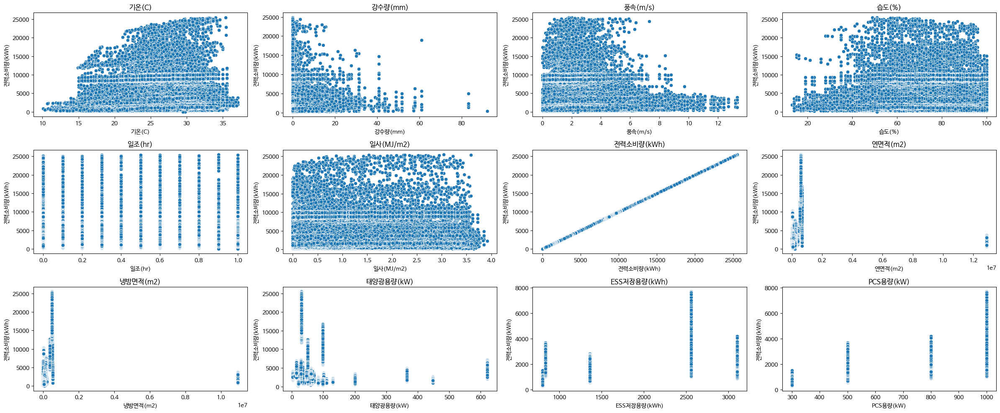

In [ ]:
def show_float_scatter(df, columns):
  i = 0
  plt.figure()
  plt.subplots(3,4,figsize=(24,10))
  for col in columns:
    i += 1
    plt.subplot(3,4,i)
    plt.title(f"{col}")
    sns.scatterplot(x=df[col], y=df['전력소비량(kWh)'])
  plt.tight_layout()
  plt.show()

show_float_scatter(df, float_features)

## Categorical Features

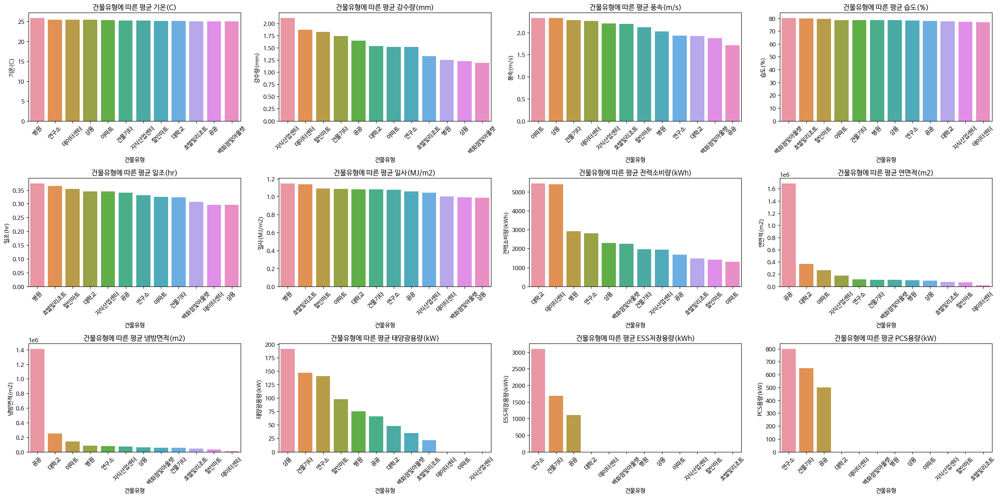

In [ ]:
i = 0
plt.subplots(3,4,figsize=(24,12))
for col in float_features:
  i += 1
  plt.subplot(3,4,i)
  data = pd.DataFrame(df.groupby(['건물유형'])[col].mean().sort_values(ascending=False))
  ax = sns.barplot(x=data.index, y=data[col])
  plt.title(f"건물유형에 따른 평균 {col}")
  plt.xticks(rotation=45)
  # for index, value in enumerate(data[col]):
  #     ax.text(index, value, f"{value:.2f}", ha='center', va='bottom', fontsize=8)
plt.tight_layout()
plt.show()

**Insight**

*조사시기는 2~3분기이며, 대부분의 전력소비는 냉방에서 일어난다. 냉방면적이 공공이 가장 큰데, 평균 전력소비량이 가장 큰 것은 대학교이다. 다른 곳에 건물 유형에 이상치들이 존재할 것이다.

## Correlation

<Axes: >

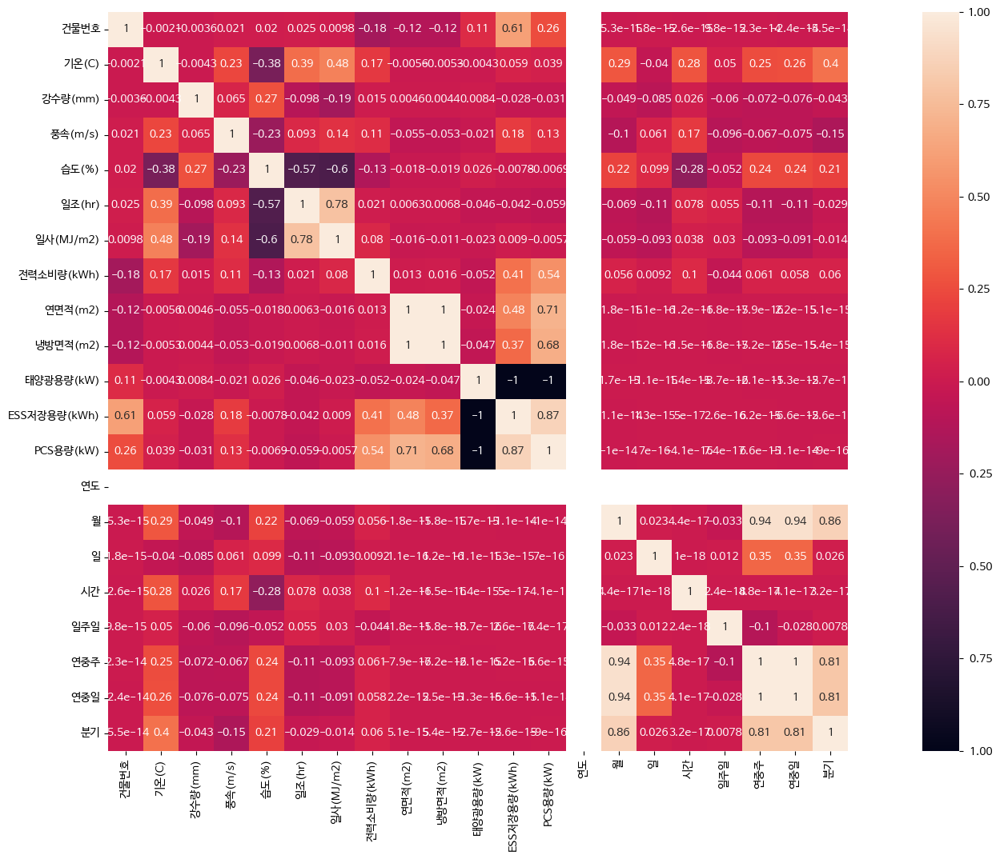

In [ ]:
plt.figure(figsize=(24,12))
sns.heatmap(df.corr(), annot=True, square=True)

## Time Series Analysis

CPU times: user 877 ms, sys: 21.5 ms, total: 899 ms
Wall time: 1.08 s


<Axes: xlabel='일시'>

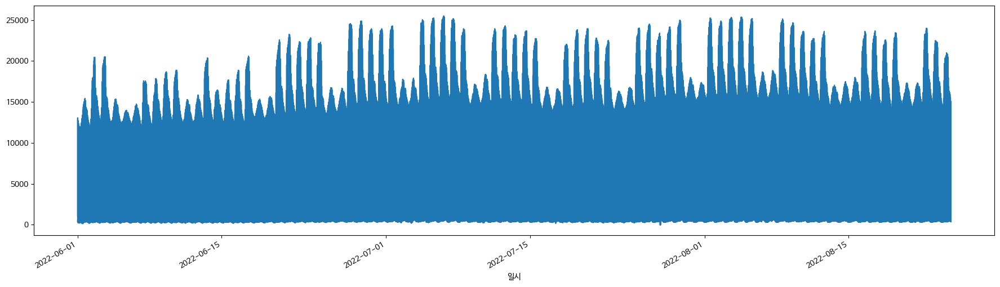

In [ ]:
%%time
plt.figure(figsize=(22,6))
df['전력소비량(kWh)'].plot();

# Feature Engineering

In [ ]:
#(cos, sin)
df['cos_day'] = np.cos(2 * np.pi * df['일'] / 365)
df['sin_day'] = np.sin(2 * np.pi * df['일'] / 365)
df['cos_month'] = np.cos(2 * np.pi * df['월'] / 12)
df['sin_month'] = np.sin(2 * np.pi * df['월'] / 12)

In [ ]:
!pip install holidays

In [ ]:
import holidays

# 한국(Korea) 휴일 활성화
kr_holidays = holidays.KR(years=2022)

df['공휴일'] = 0

# 데이터프레임 내의 '일자' 컬럼을 기준으로 공휴일인 날짜를 찾아 '공휴일' 컬럼을 1로 설정
for date in kr_holidays:
  print(date)
  df.loc[df['일시'] == date, '공휴일'] = 1

2022-01-01
2022-02-01
2022-01-31
2022-02-02
2022-03-01
2022-05-08
2022-05-05
2022-05-01
2022-06-06
2022-08-15
2022-09-10
2022-09-09
2022-09-11
2022-09-12
2022-10-03
2022-10-09
2022-10-10
2022-12-25


In [ ]:
df.loc[df['일시'] == '2022-06-06', '공휴일'] = 1
df.loc[df['일시'] == '2022-08-15', '공휴일'] = 1

# Data Postprocessing

In [ ]:
# df.to_csv("/content/drive/MyDrive/Datasets/데이콘/power_usage/new_df.csv",index=False)

# NEW DATA

In [ ]:
#NEW DATA
df = pd.read_csv("/content/drive/MyDrive/Datasets/데이콘/power_usage/new_df.csv")

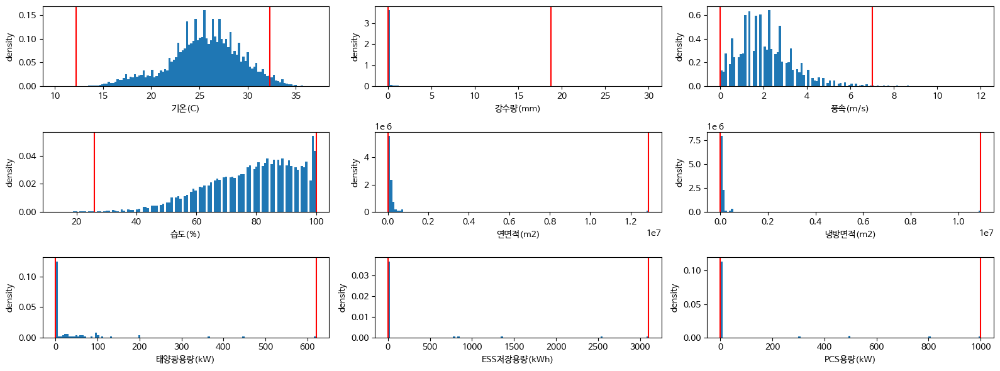

In [ ]:
features = ['기온(C)',
 '강수량(mm)',
 '풍속(m/s)',
 '습도(%)',
 '연면적(m2)',
 '냉방면적(m2)',
 '태양광용량(kW)',
 'ESS저장용량(kWh)',
 'PCS용량(kW)']
f, ax = plt.subplots(3,3, figsize=(16,6))
ax = ax.ravel()
for ax, f in zip(ax, features):
  ax.hist(train[f], bins=120, density=True)
  ax.set_xlabel(f)
  ax.set_ylabel('density')
  ax.axvline(test[f].min(), color='r')
  ax.axvline(test[f].max(), color='r')
plt.tight_layout()
plt.show()

In [ ]:
# outlier
cond = (df['강수량(mm)'] > 20) | (df['풍속(m/s)'] > 10)
df.drop(df[cond].index, inplace=True)

In [ ]:
train = df[~df['전력소비량(kWh)'].isna()]
test = df[df['전력소비량(kWh)'].isna()].drop(['전력소비량(kWh)'],1)

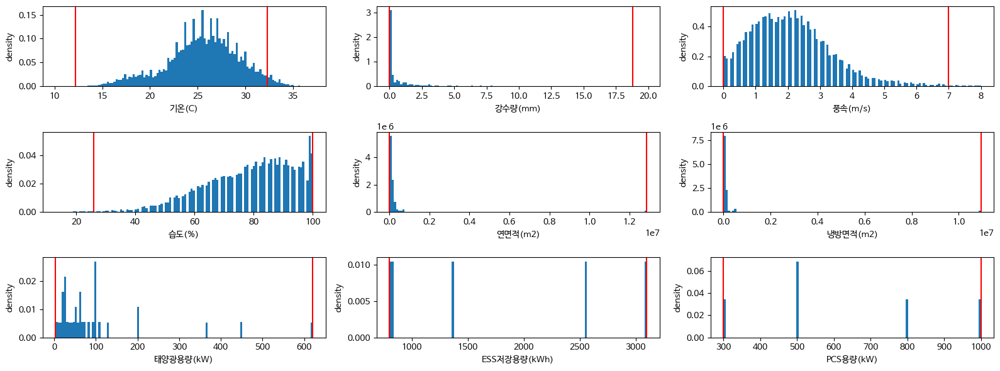

In [ ]:
features = ['기온(C)',
 '강수량(mm)',
 '풍속(m/s)',
 '습도(%)',
 '연면적(m2)',
 '냉방면적(m2)',
 '태양광용량(kW)',
 'ESS저장용량(kWh)',
 'PCS용량(kW)']
f, ax = plt.subplots(3,3, figsize=(16,6))
ax = ax.ravel()
for ax, f in zip(ax, features):
  ax.hist(train[f], bins=120, density=True)
  ax.set_xlabel(f)
  ax.set_ylabel('density')
  ax.axvline(test[f].min(), color='r')
  ax.axvline(test[f].max(), color='r')
plt.tight_layout()
plt.show()